In [1]:
import numpy as np
import tensorflow as tf
import keras
import cv2
from keras.layers import MaxPool2D,Conv2D,UpSampling2D,Input,Dropout
from keras.models import Sequential
from tensorflow.keras.utils import img_to_array
import os
from tqdm import tqdm
import re
import matplotlib.pyplot as plt

In [2]:
# to get the files in proper order
def sorted_alphanumeric(data):  
    convert = lambda text: int(text) if text.isdigit() else text.lower()
    alphanum_key = lambda key: [convert(c) for c in re.split('([0-9]+)',key)]
    return sorted(data,key = alphanum_key)
# defining the size of the image
SIZE = 160
color_img = []
path = '../DATA/landscapeImages/color'
files = os.listdir(path)
files = sorted_alphanumeric(files)
for i in tqdm(files):    
      
    img = cv2.imread(path + '/'+i,1)
    # open cv reads images in BGR format so we have to convert it to RGB
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    #resizing image
    img = cv2.resize(img, (SIZE, SIZE))
    img = img.astype('float32') / 255.0
    color_img.append(img_to_array(img))


gray_img = []
path = '../DATA/landscapeImages/gray'
files = os.listdir(path)
files = sorted_alphanumeric(files)
for i in tqdm(files):
    img = cv2.imread(path + '/'+i,1)

    #resizing image
    img = cv2.resize(img, (SIZE, SIZE))
    img = img.astype('float32') / 255.0
    gray_img.append(img_to_array(img))


100%|██████████| 7129/7129 [00:05<00:00, 1266.63it/s]


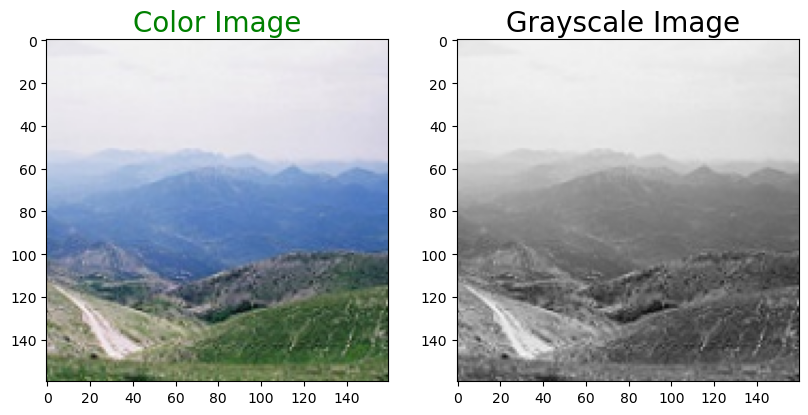

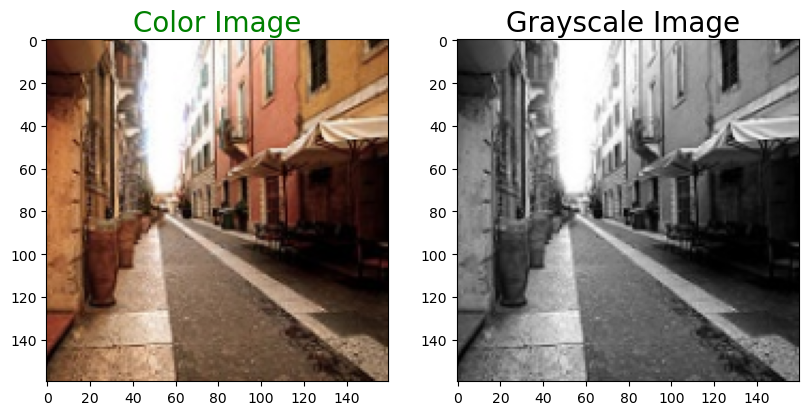

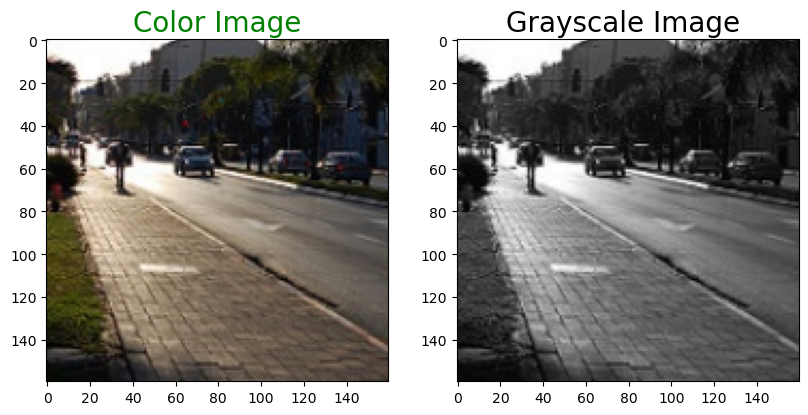

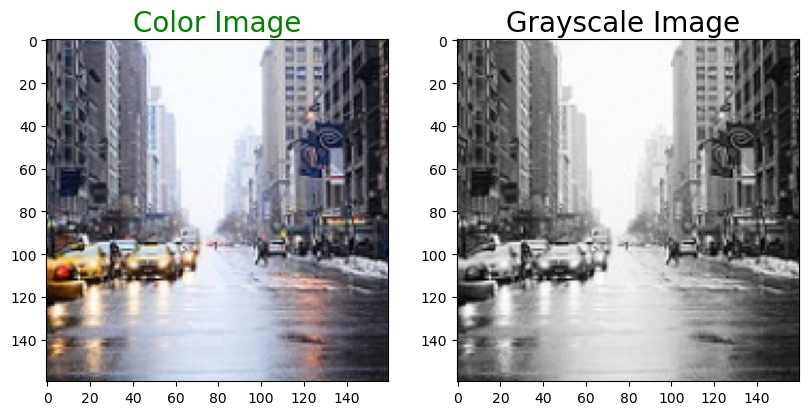

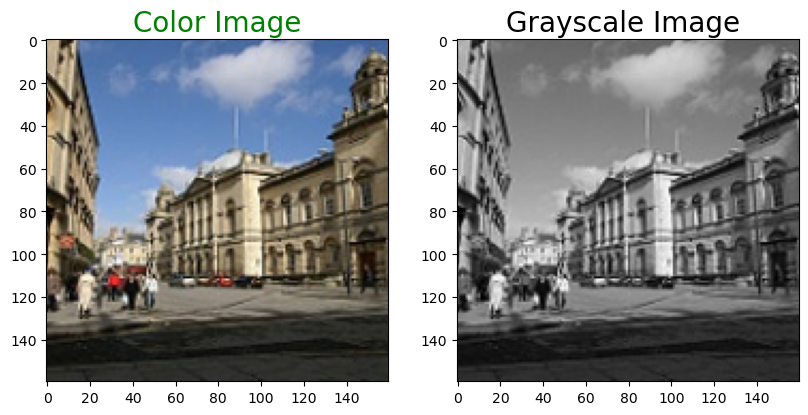

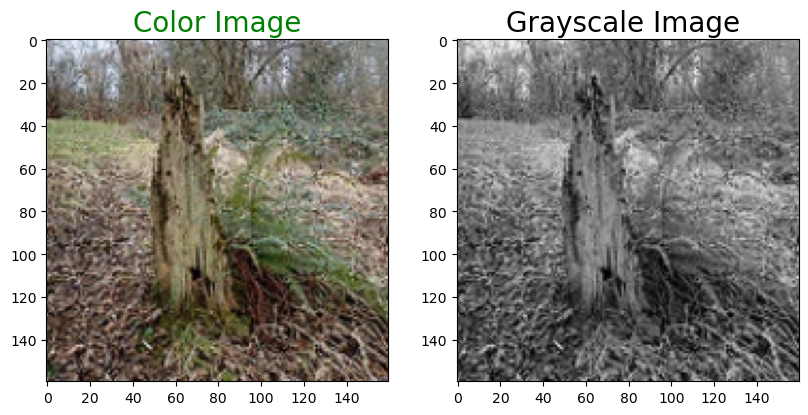

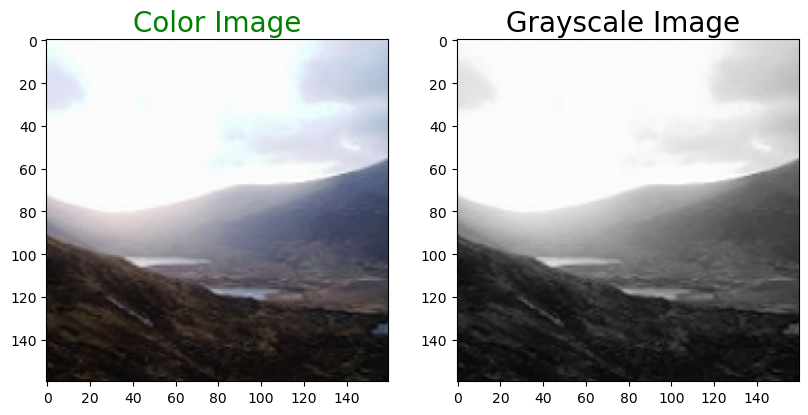

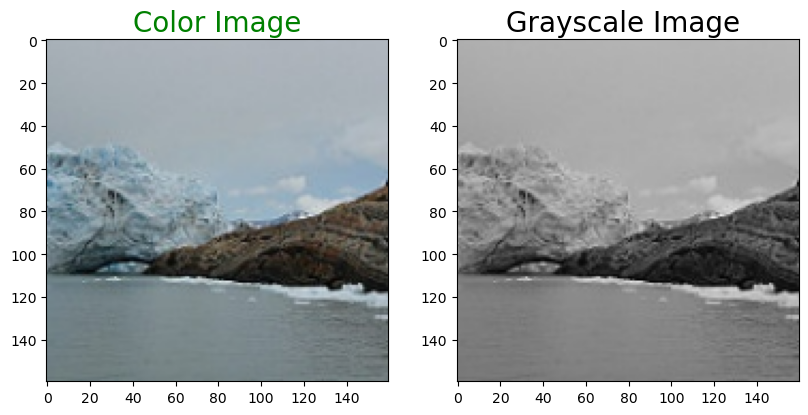

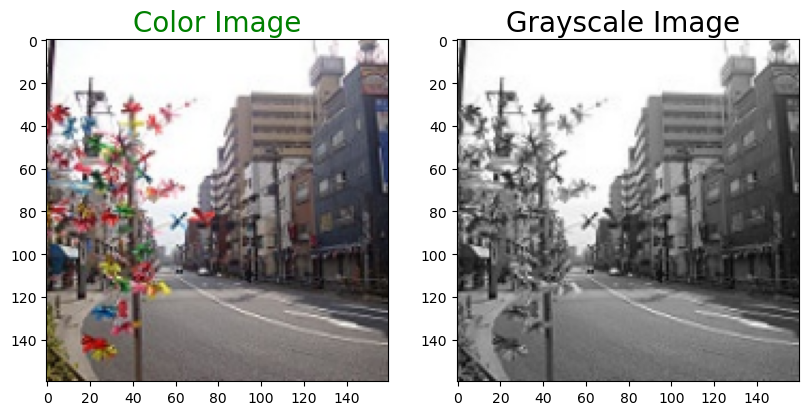

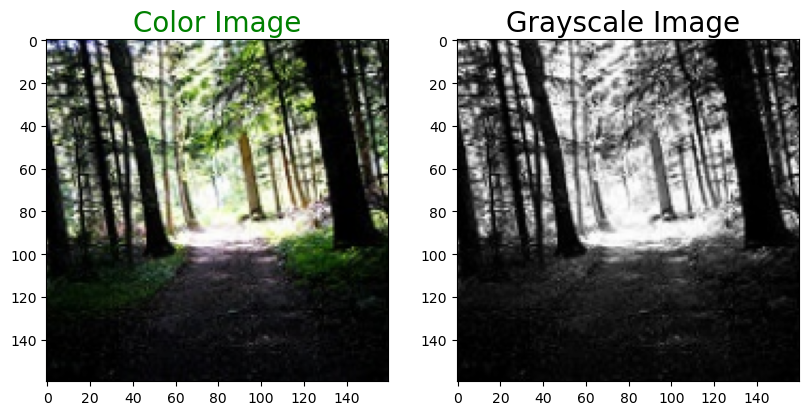

In [3]:
def plot_images(color,grayscale):
    plt.figure(figsize=(15,15))
    plt.subplot(1,3,1)
    plt.title('Color Image', color = 'green', fontsize = 20)
    plt.imshow(color)
    plt.subplot(1,3,2)
    plt.title('Grayscale Image ', color = 'black', fontsize = 20)
    plt.imshow(grayscale)
    plt.show()

for i in range(20,30):
     plot_images(color_img[i],gray_img[i])

In [4]:
# train split 
len_data = len(color_img)
train_size = int(len_data*0.8)

train_gray_image = gray_img[:train_size]
train_color_image = color_img[:train_size]

test_gray_image = gray_img[train_size:]
test_color_image = color_img[train_size:]

train_g = np.reshape(train_gray_image,(len(train_gray_image),SIZE,SIZE,3))
train_c = np.reshape(train_color_image, (len(train_color_image),SIZE,SIZE,3))
print('Train color image shape:',train_c.shape)


test_gray_image = np.reshape(test_gray_image,(len(test_gray_image),SIZE,SIZE,3))
test_color_image = np.reshape(test_color_image, (len(test_color_image),SIZE,SIZE,3))
print('Test color image shape',test_color_image.shape)

Train color image shape: (5703, 160, 160, 3)
Test color image shape (1426, 160, 160, 3)


In [5]:
from AE_RESNET.resnetAE import ResNetAE
from AE_RESNET.resnetAE_mod import ResNetAE_mod

In [6]:
resnet34AEMod = ResNetAE_mod(input_shape=(SIZE,SIZE,3), output_channels=3, resnet_decoder=True,
                              bottleneck_layers=[3,4,6,3],bottleneck_strides=[1,2,2,2], 
                              bottleneck_num_layer=2)
resnet34AEMod.summary()

Model: "ResNetAEMod"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 ResNet_encoder (Functional)    (None, 5, 5, 512)    22723648    ['input_1[0][0]']                
                                                                                                  
 ResNet_decoder (Functional)    (None, 160, 160, 3)  27368207    ['ResNet_encoder[0][0]']         
                                                                                                  
 concatenate (Concatenate)      (None, 160, 160, 6)  0           ['input_1[0][0]',      

In [7]:
optimizer = keras.optimizers.Adam(learning_rate=0.001)
resnet34AEMod.compile(optimizer=optimizer, loss="mae")

early_stopping = keras.callbacks.EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

history = resnet34AEMod.fit(
    train_g,
    train_c,
    epochs=60,
    batch_size=64, 
    shuffle=True,
    validation_split=0.1, 
    callbacks=[]
    )

Epoch 1/60
81/81 [==============================] - 59s 621ms/step - loss: 0.1694 - val_loss: 0.2526
Epoch 2/60
81/81 [==============================] - 46s 574ms/step - loss: 0.0935 - val_loss: 0.2761
Epoch 3/60
81/81 [==============================] - 47s 575ms/step - loss: 0.0778 - val_loss: 0.1907
Epoch 4/60
81/81 [==============================] - 47s 575ms/step - loss: 0.0709 - val_loss: 0.1242
Epoch 5/60
81/81 [==============================] - 47s 575ms/step - loss: 0.0663 - val_loss: 0.0930
Epoch 6/60
81/81 [==============================] - 47s 575ms/step - loss: 0.0628 - val_loss: 0.0969
Epoch 7/60
81/81 [==============================] - 47s 575ms/step - loss: 0.0608 - val_loss: 0.0801
Epoch 8/60
81/81 [==============================] - 47s 575ms/step - loss: 0.0594 - val_loss: 0.0892
Epoch 9/60
81/81 [==============================] - 47s 575ms/step - loss: 0.0578 - val_loss: 0.0838
Epoch 10/60
81/81 [==============================] - 47s 575ms/step - loss: 0.0567 - val_lo

1/1 [==============================] - 1s 780ms/step


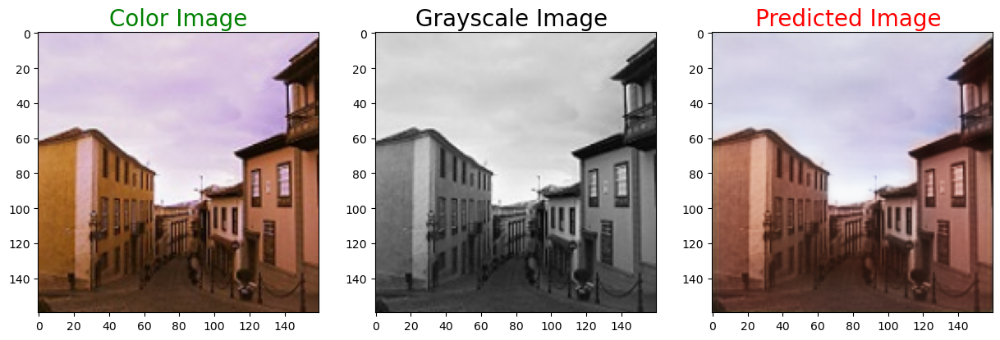

1/1 [==============================] - 0s 17ms/step


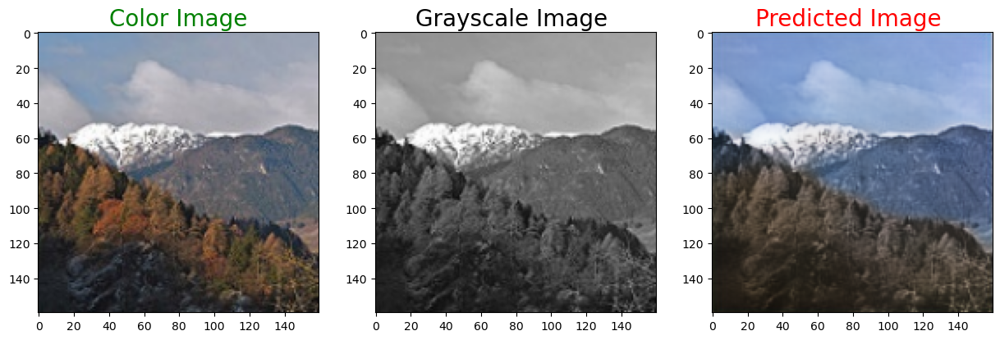

1/1 [==============================] - 0s 26ms/step


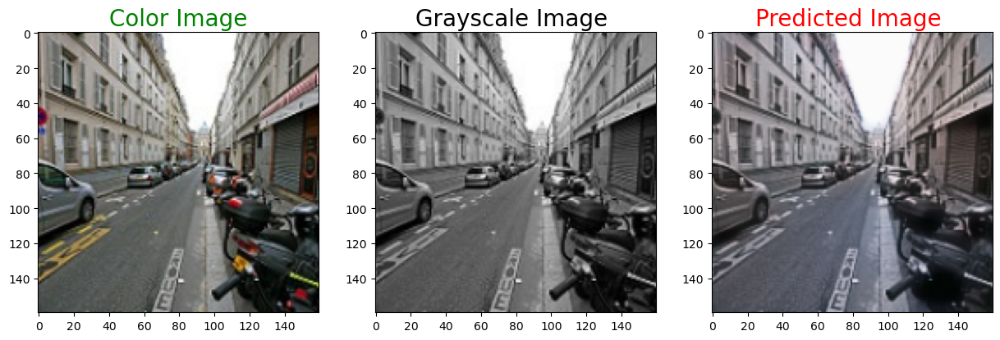

1/1 [==============================] - 0s 18ms/step


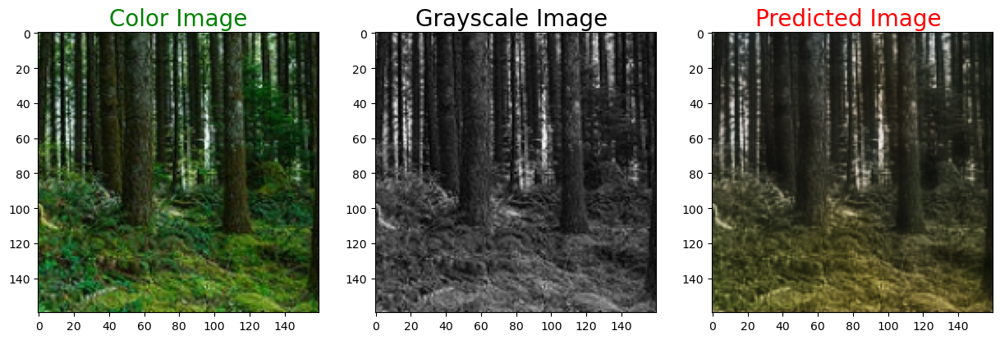

1/1 [==============================] - 0s 28ms/step


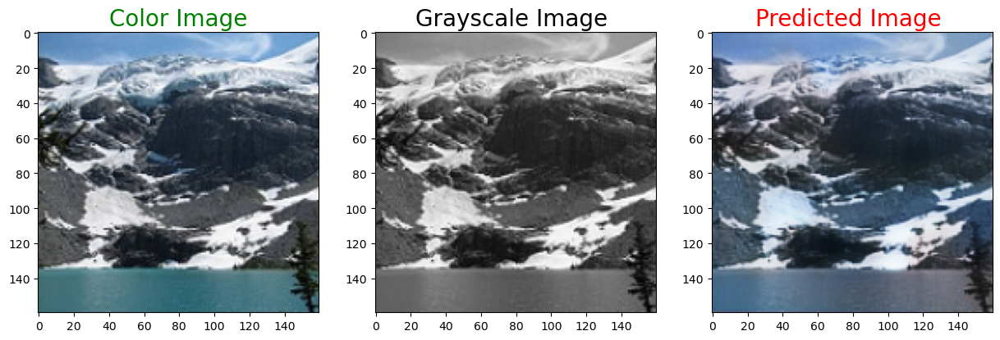

1/1 [==============================] - 0s 16ms/step


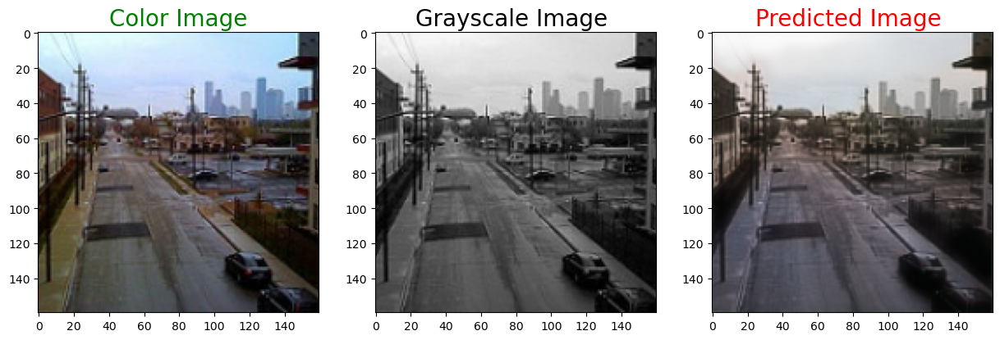

1/1 [==============================] - 0s 20ms/step


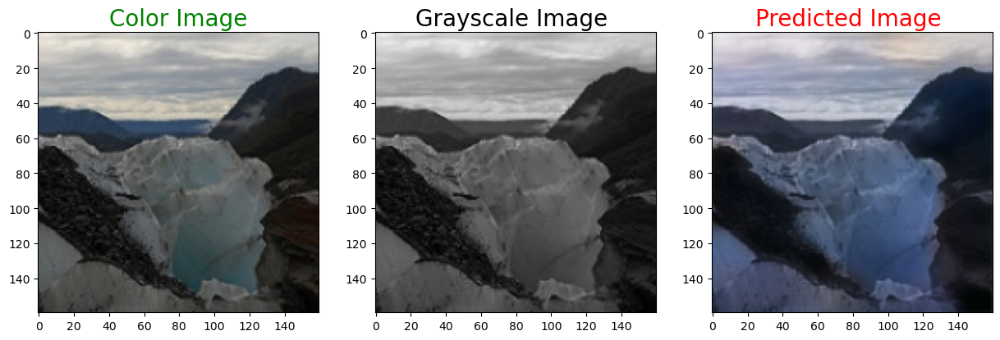

1/1 [==============================] - 0s 18ms/step


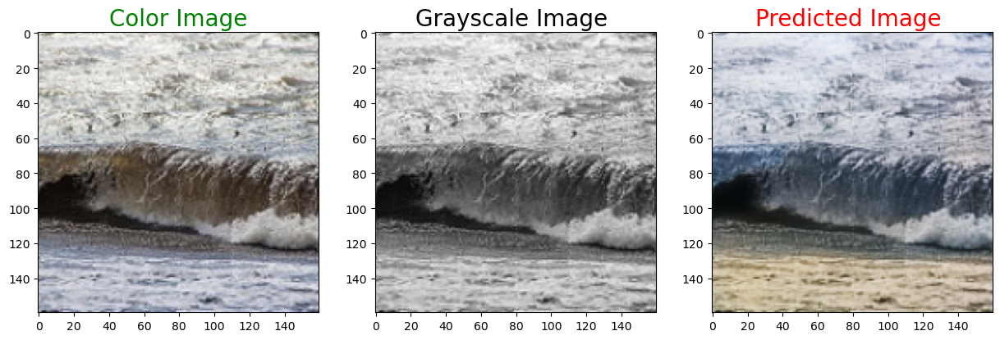

In [8]:
def plot_images(color,grayscale,predicted):
    plt.figure(figsize=(15,15))
    plt.subplot(1,3,1)
    plt.title('Color Image', color = 'green', fontsize = 20)
    plt.imshow(color)
    plt.subplot(1,3,2)
    plt.title('Grayscale Image ', color = 'black', fontsize = 20)
    plt.imshow(grayscale)
    plt.subplot(1,3,3)
    plt.title('Predicted Image ', color = 'Red', fontsize = 20)
    plt.imshow(predicted)
   
    plt.show()

for i in range(75,83):
    predicted = np.clip(resnet34AEMod.predict(test_gray_image[i].reshape(1,SIZE, SIZE,3)),0.0,1.0).reshape(SIZE, SIZE,3)
    plot_images(test_color_image[i],test_gray_image[i],predicted)

1/1 [==============================] - 0s 15ms/step


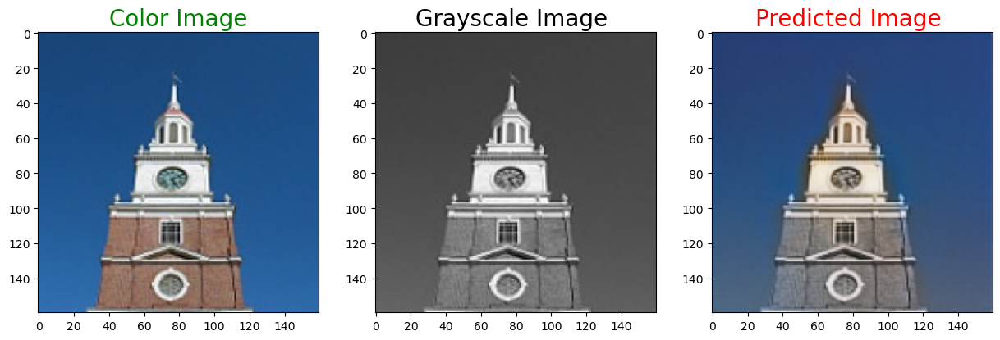

1/1 [==============================] - 0s 16ms/step


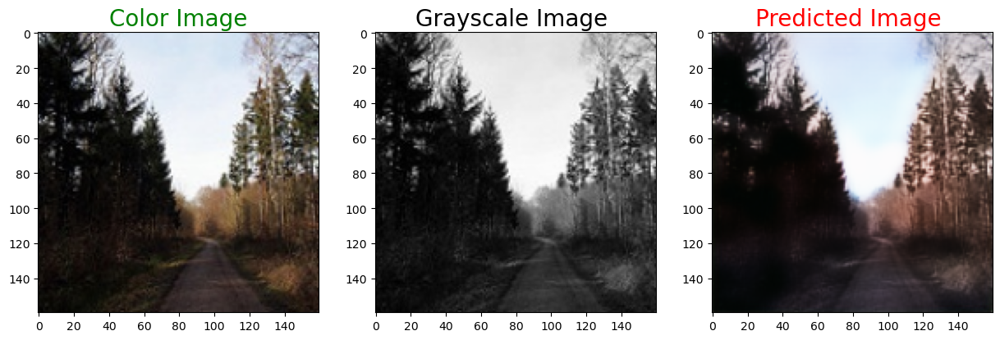

1/1 [==============================] - 0s 18ms/step


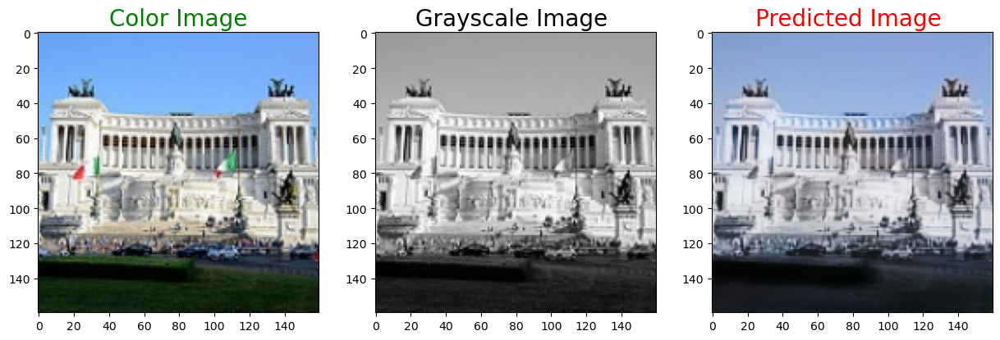

1/1 [==============================] - 0s 16ms/step


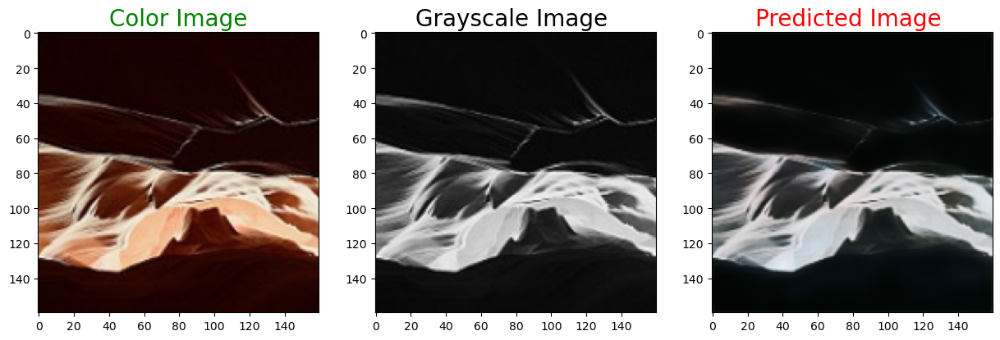

1/1 [==============================] - 0s 18ms/step


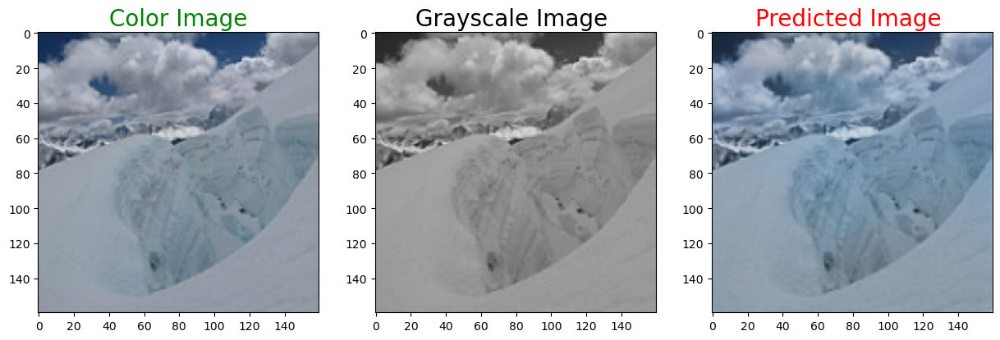

1/1 [==============================] - 0s 25ms/step


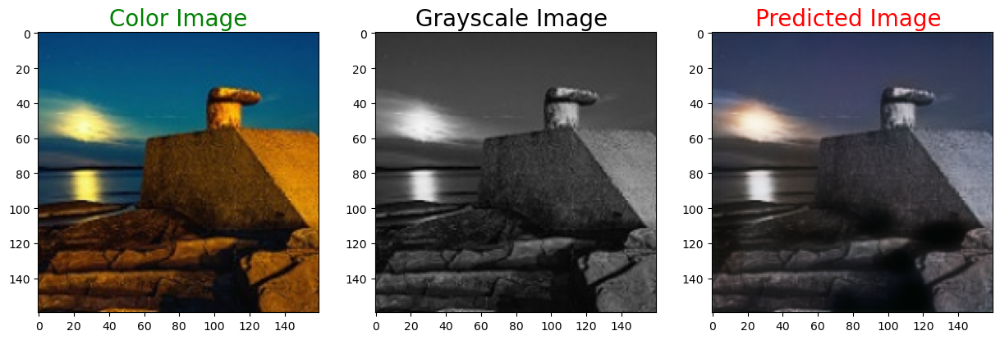

1/1 [==============================] - 0s 22ms/step


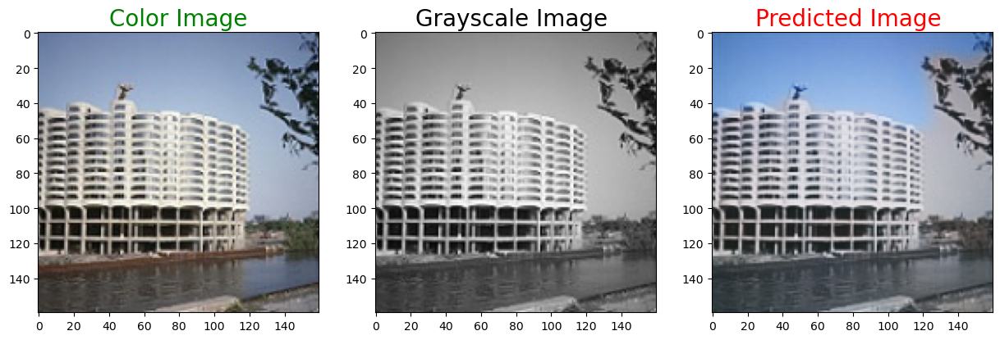

1/1 [==============================] - 0s 24ms/step


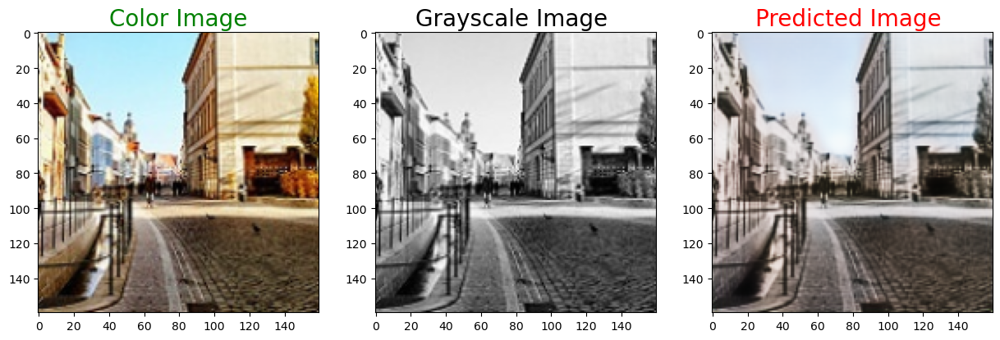

In [9]:
for i in range(500,508):
    predicted = np.clip(resnet34AEMod.predict(test_gray_image[i].reshape(1,SIZE, SIZE,3)),0.0,1.0).reshape(SIZE, SIZE,3)
    plot_images(test_color_image[i],test_gray_image[i],predicted)

In [10]:
resnet34AEMod.save('final_models/resnet34AE_mod_lr001.h5')

In [11]:
predictions = resnet34AEMod.predict(test_gray_image)
test_data_prue = np.squeeze(test_gray_image)
predictions_prue = np.squeeze(predictions)

resnet34AEMod.evaluate(test_data_prue, predictions_prue, channel_axis=-1)

45/45 [==============================] - 5s 92ms/step
SSIM: 0.9708687663078308
PSNR: 24.291950794762414


In [12]:
import matplotlib.pyplot as plt
import numpy as np

def plot_lr(history):
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title('Model Loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Validation'], loc='upper left')
    plt.show()

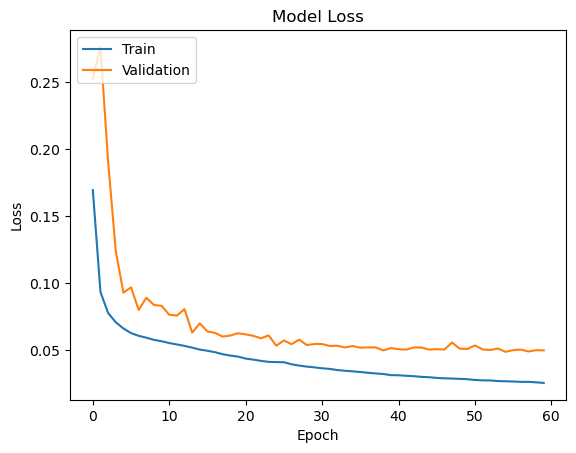

In [13]:
plot_lr(history)

In [6]:
resnet34AE = ResNetAE(input_shape=(SIZE,SIZE,3), output_channels=3, resnet_decoder=True,
                      bottleneck_layers=[3,4,6,3],bottleneck_strides=[1,2,2,2], 
                      bottleneck_num_layer=2)
resnet34AE.summary()

Model: "ResNetAE"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 160, 160, 3)]     0         
                                                                 
 ResNet_encoder (Functional)  (None, 5, 5, 512)        22723648  
                                                                 
 ResNet_decoder (Functional)  (None, 160, 160, 3)      27368207  
                                                                 
Total params: 50,091,855
Trainable params: 50,057,673
Non-trainable params: 34,182
_________________________________________________________________


In [7]:
optimizer = keras.optimizers.Adam(learning_rate=0.0001)
resnet34AE.compile(optimizer=optimizer, loss="mae")

early_stopping = keras.callbacks.EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

history = resnet34AE.fit(
    train_g,
    train_c,
    epochs=40,
    batch_size=32, 
    shuffle=True,
    validation_split=0.1, 
    callbacks=[]
    )

Epoch 1/40
161/161 [==============================] - 55s 293ms/step - loss: 0.1432 - val_loss: 0.1911
Epoch 2/40
161/161 [==============================] - 45s 278ms/step - loss: 0.1156 - val_loss: 0.1426
Epoch 3/40
161/161 [==============================] - 45s 277ms/step - loss: 0.1095 - val_loss: 0.1136
Epoch 4/40
161/161 [==============================] - 45s 278ms/step - loss: 0.1049 - val_loss: 0.1053
Epoch 5/40
161/161 [==============================] - 45s 277ms/step - loss: 0.1018 - val_loss: 0.1104
Epoch 6/40
161/161 [==============================] - 45s 277ms/step - loss: 0.0996 - val_loss: 0.0992
Epoch 7/40
161/161 [==============================] - 45s 277ms/step - loss: 0.0959 - val_loss: 0.0995
Epoch 8/40
161/161 [==============================] - 45s 277ms/step - loss: 0.0941 - val_loss: 0.1073
Epoch 9/40
161/161 [==============================] - 45s 277ms/step - loss: 0.0917 - val_loss: 0.1054
Epoch 10/40
161/161 [==============================] - 45s 277ms/step - l

1/1 [==============================] - 1s 759ms/step


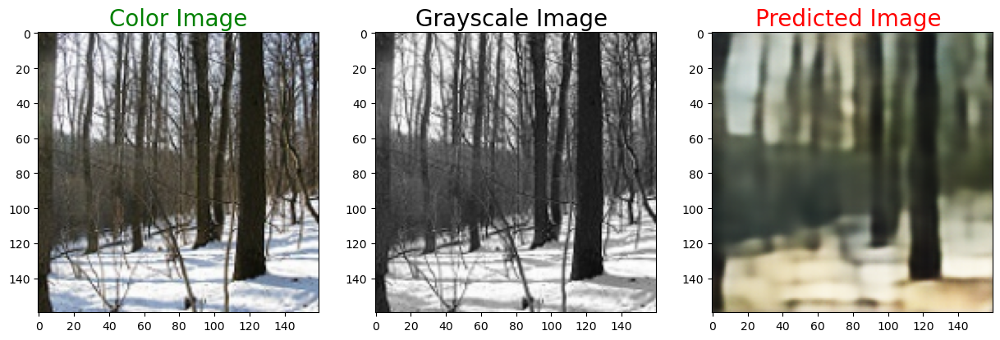

1/1 [==============================] - 0s 22ms/step


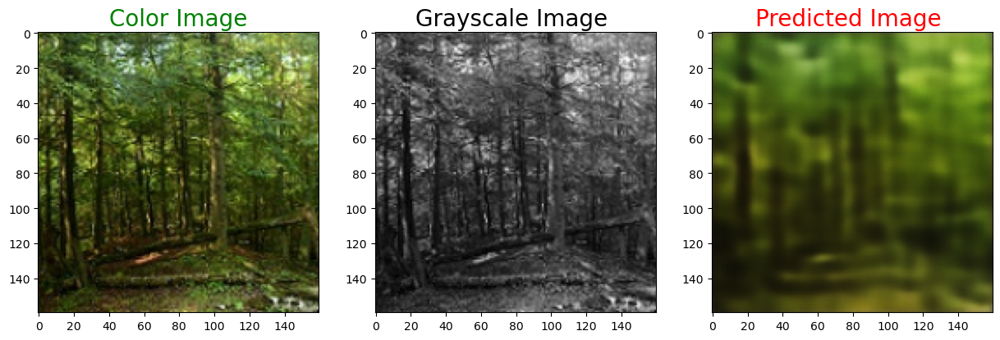

1/1 [==============================] - 0s 17ms/step


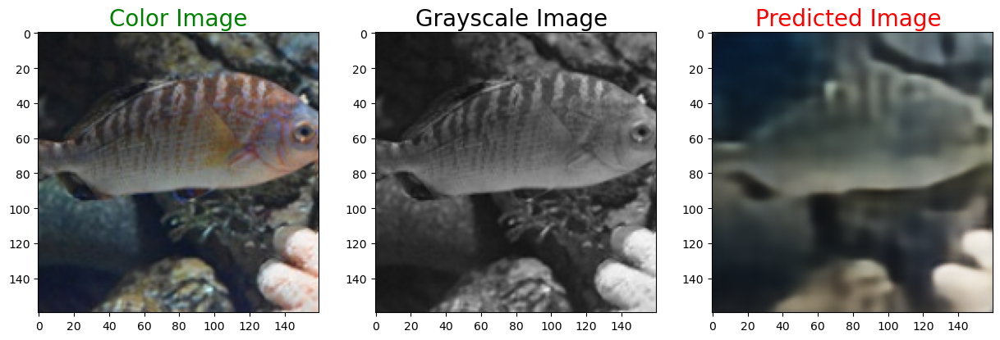

1/1 [==============================] - 0s 18ms/step


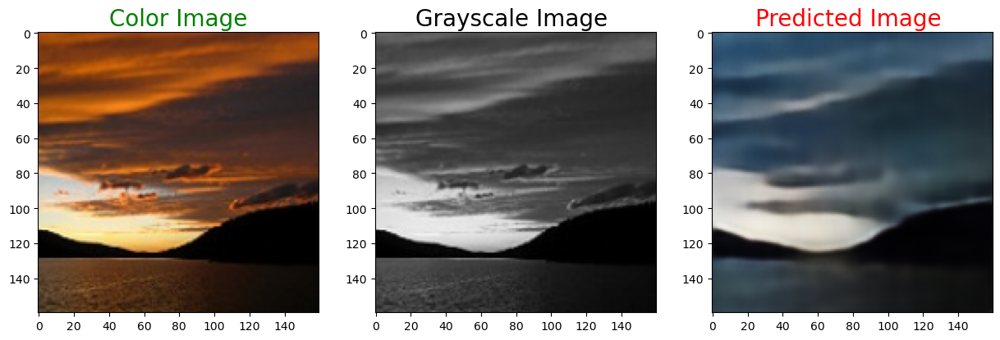

1/1 [==============================] - 0s 18ms/step


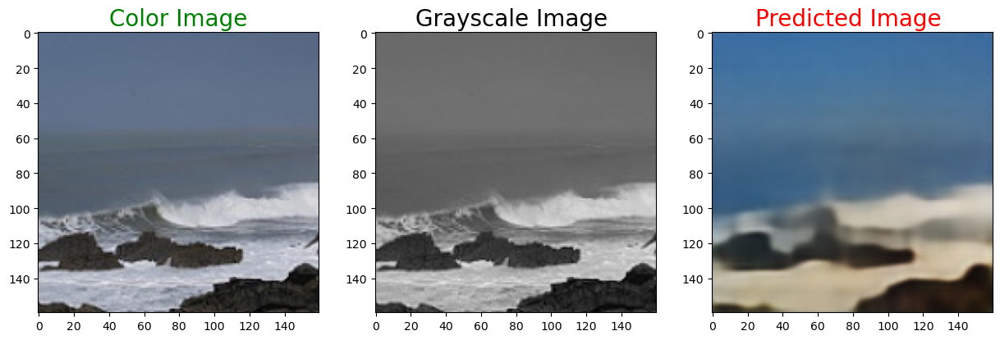

1/1 [==============================] - 0s 21ms/step


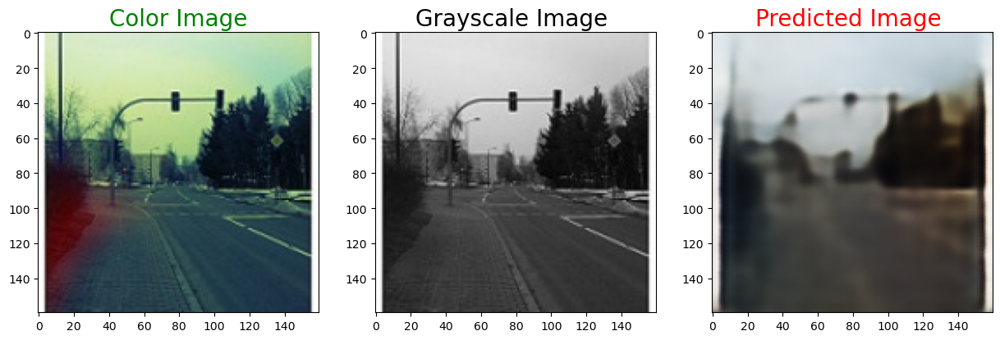

1/1 [==============================] - 0s 16ms/step


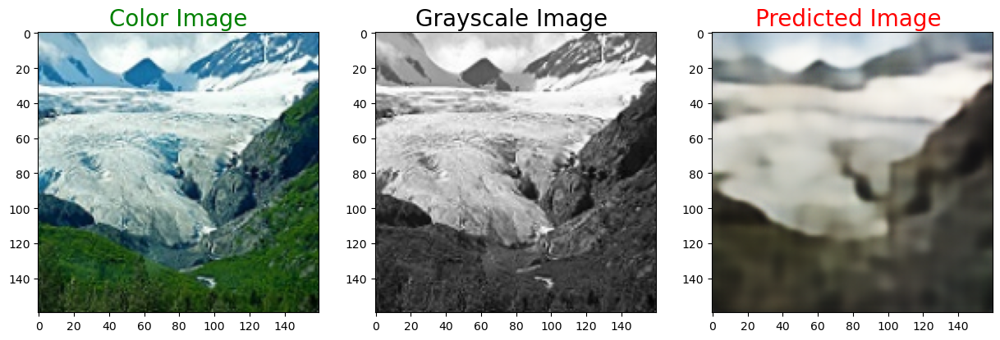

1/1 [==============================] - 0s 17ms/step


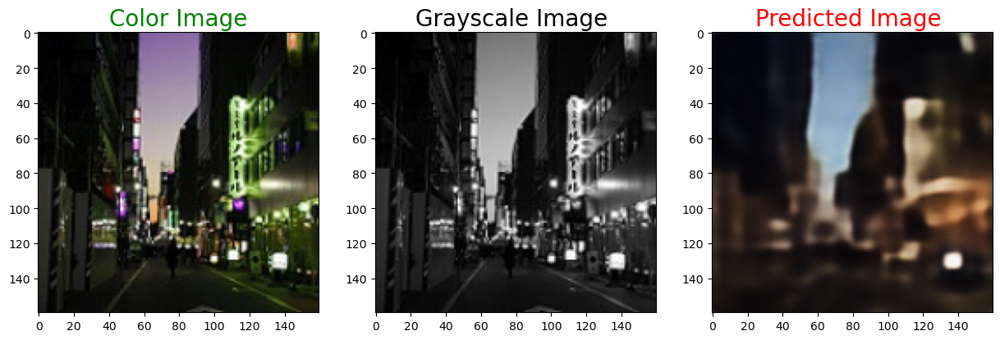

In [8]:
# defining function to plot images pair
def plot_images(color,grayscale,predicted):
    plt.figure(figsize=(15,15))
    plt.subplot(1,3,1)
    plt.title('Color Image', color = 'green', fontsize = 20)
    plt.imshow(color)
    plt.subplot(1,3,2)
    plt.title('Grayscale Image ', color = 'black', fontsize = 20)
    plt.imshow(grayscale)
    plt.subplot(1,3,3)
    plt.title('Predicted Image ', color = 'Red', fontsize = 20)
    plt.imshow(predicted)
   
    plt.show()

for i in range(50,58):
    predicted = np.clip(resnet34AE.predict(test_gray_image[i].reshape(1,SIZE, SIZE,3)),0.0,1.0).reshape(SIZE, SIZE,3)
    plot_images(test_color_image[i],test_gray_image[i],predicted)

1/1 [==============================] - 0s 16ms/step


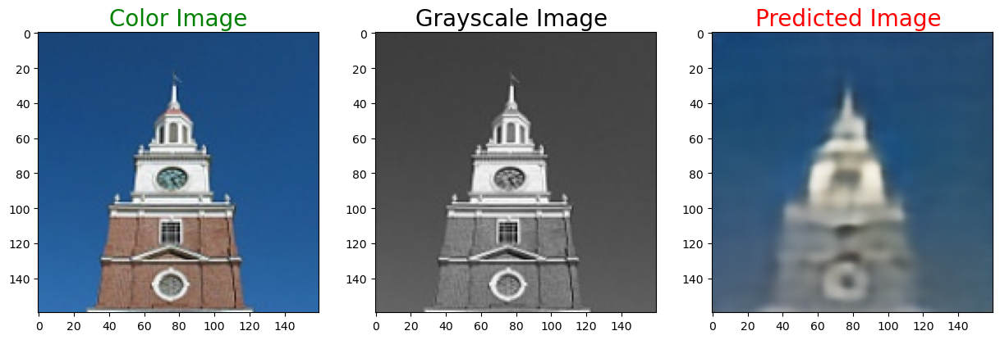

1/1 [==============================] - 0s 15ms/step


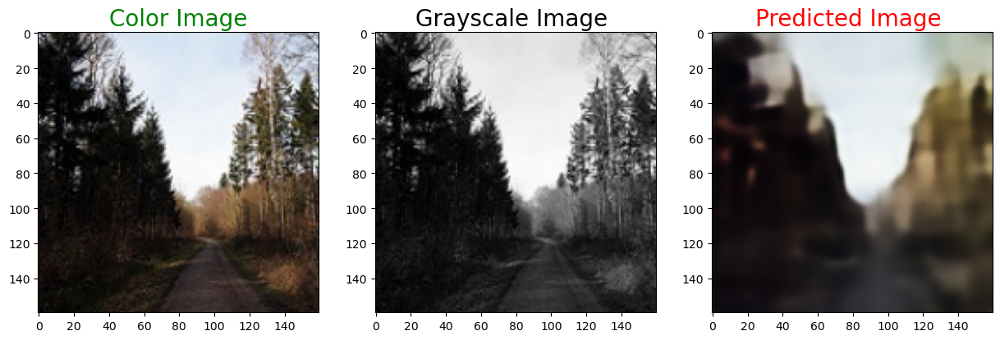

1/1 [==============================] - 0s 17ms/step


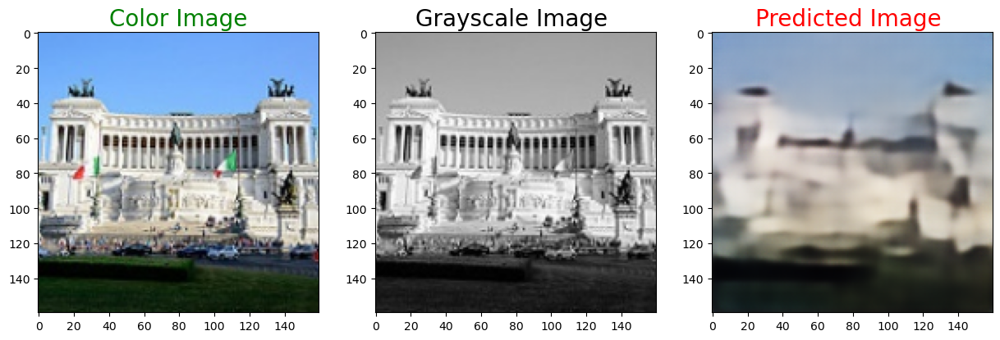

1/1 [==============================] - 0s 16ms/step


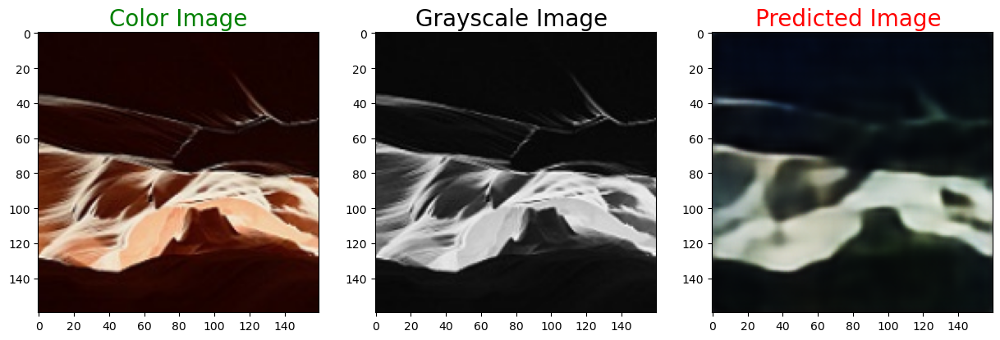

1/1 [==============================] - 0s 17ms/step


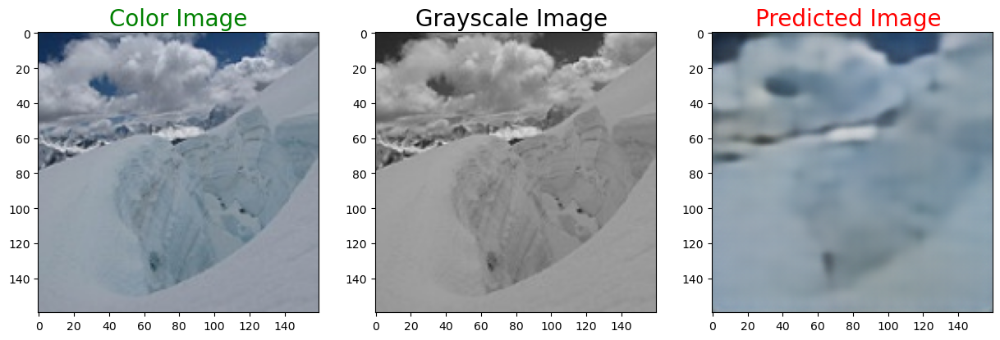

1/1 [==============================] - 0s 16ms/step


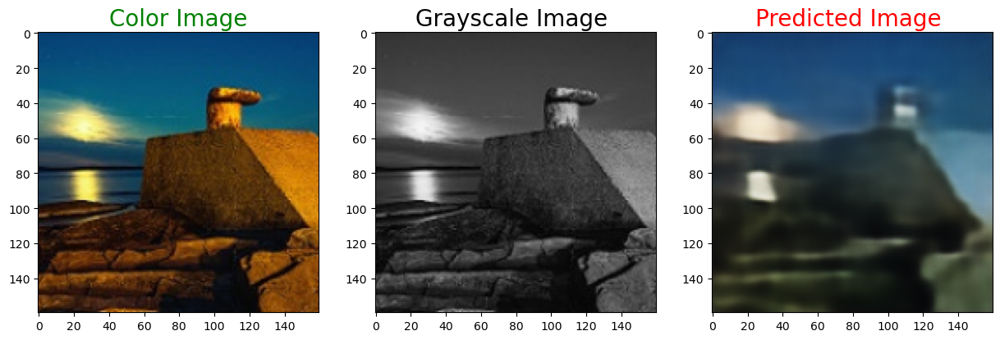

1/1 [==============================] - 0s 23ms/step


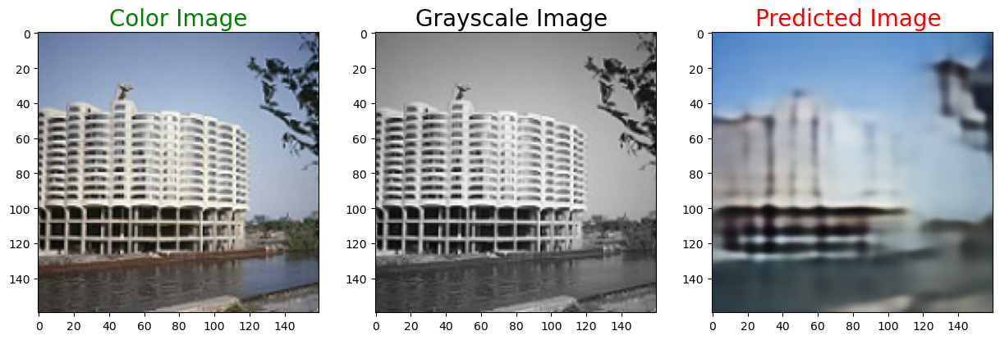

1/1 [==============================] - 0s 21ms/step


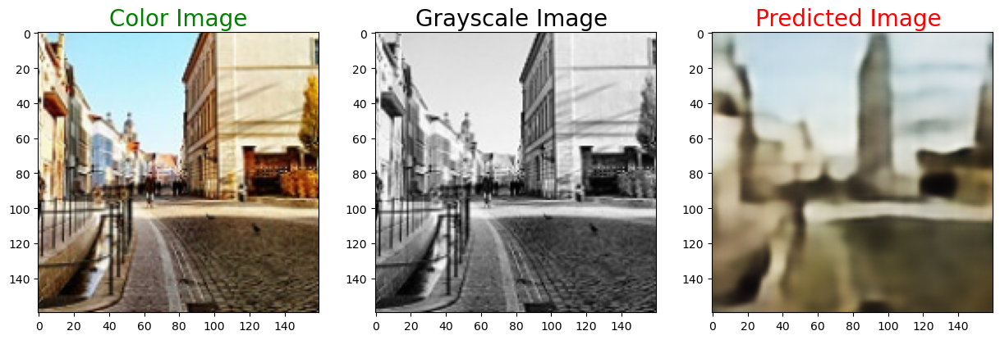

In [9]:
for i in range(500,508):
    predicted = np.clip(resnet34AE.predict(test_gray_image[i].reshape(1,SIZE, SIZE,3)),0.0,1.0).reshape(SIZE, SIZE,3)
    plot_images(test_color_image[i],test_gray_image[i],predicted)

In [10]:
predictions = resnet34AE.predict(test_gray_image)
test_data_prue = np.squeeze(test_gray_image)
predictions_prue = np.squeeze(predictions)

45/45 [==============================] - 4s 93ms/step


In [11]:
resnet34AE.evaluate(test_data_prue, predictions_prue, channel_axis=-1)

SSIM: 0.8702859282493591
PSNR: 19.299048142144002


In [12]:
resnet34AE.save('final_models/resnet34AE_lr0001.h5')

In [13]:
def plot_lr(history):
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title('Model Loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Validation'], loc='upper left')
    plt.show()

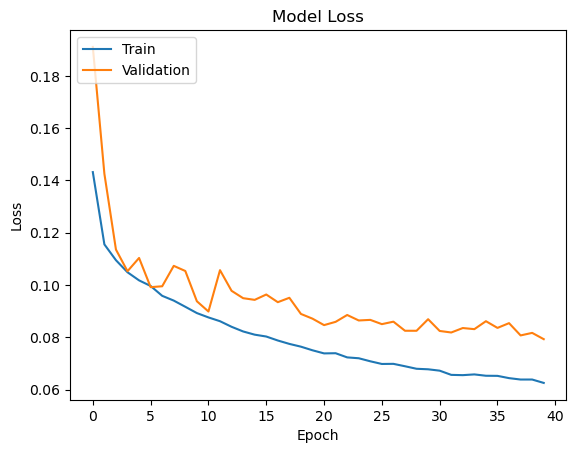

In [14]:
plot_lr(history)